# Evaluate noise filtering
How effectively can we use the noise filtering capabilities of sox

The noise profile is generated from the automatically generated silent parts of the audio.

Log for interactive will be written in log-2020-10-25_12-44-29
Loaded audio tracks from simple_call_2/audio/
Already processed: simple_call_2\audio\B2_C_B_Jt1_16_07_06_042_000693.63_B2.wav, simple_call_2\audio\B2_C_TR_Jt1_16_06_02_018_000022.58_B2.wav, simple_call_2\audio\B2_C_TR_Jt1_16_06_02_018_000129.77_B4.wav, ... (1315 others)


,label,Origin,nr12,nr25,nr65
0,B2,,,,
1,B2,,,,
2,B2,,,,
3,B2,,,,
4,B2,,,,
5,B2,,,,
6,B2,,,,
7,B2,,,,
8,B2,,,,
9,B2,,,,

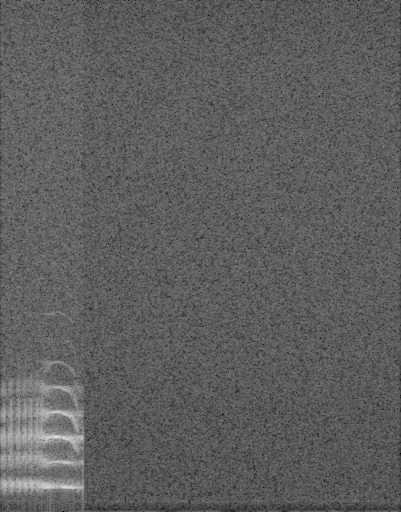
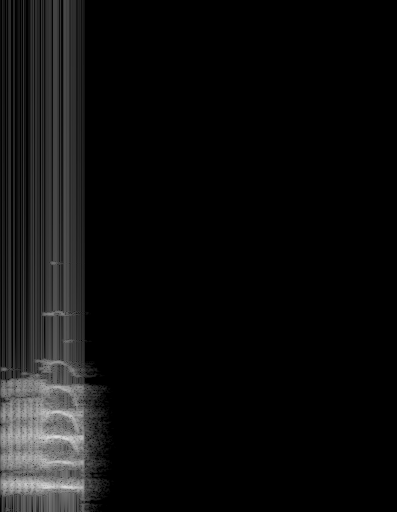
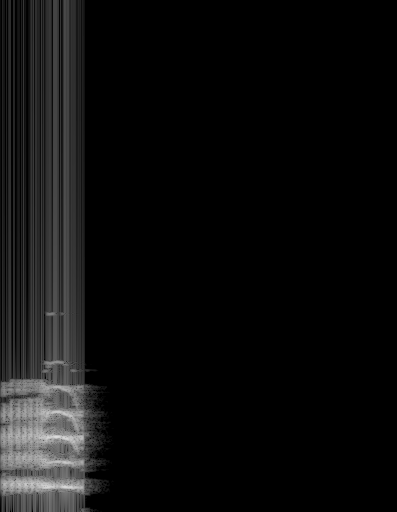
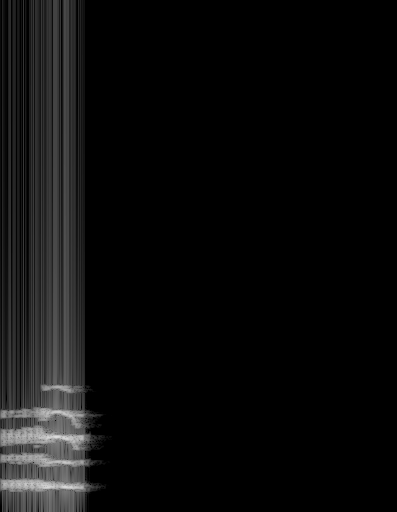
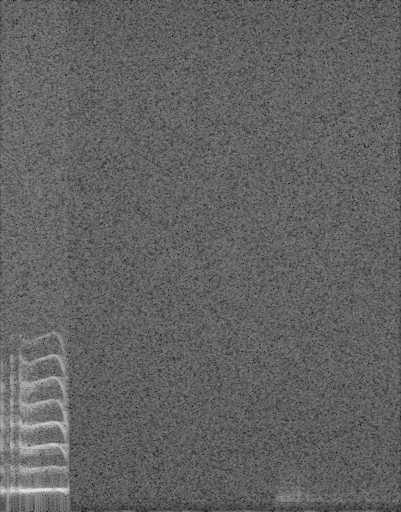
...
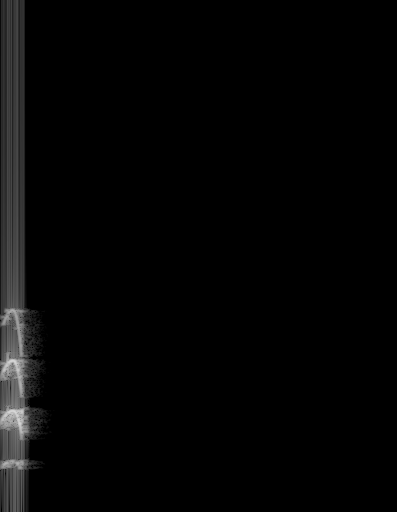
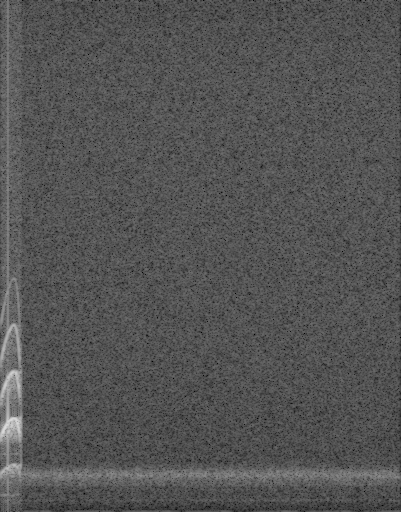
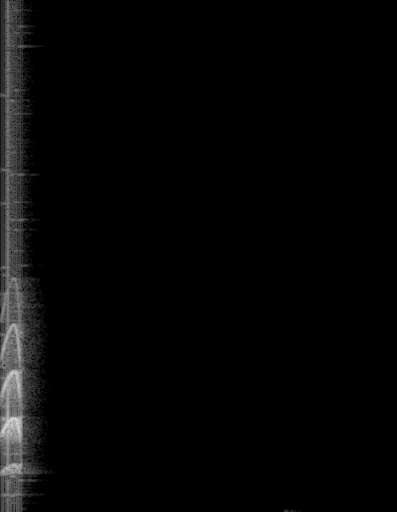
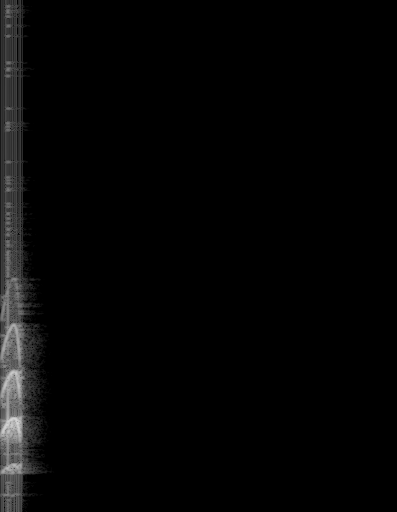
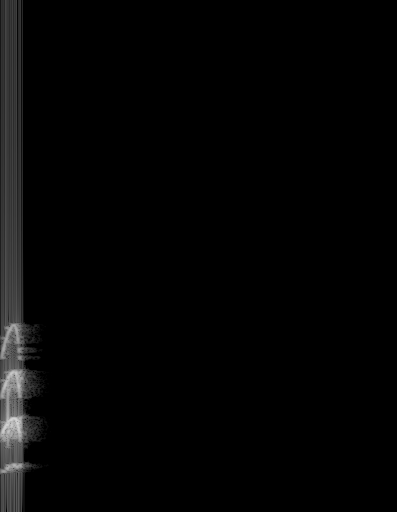

In [1]:
import base64, random
from IPython.display import HTML, display, Image
from engine.metadata import metadata_db
from engine.audio import load_audio
from engine.settings import BSC_ROOT_DATA_FOLDER
from collections import defaultdict
import numpy as np
import pandas as pd

mdb = metadata_db('simple_call_2/metadata.json')
files = load_audio(mdb, 'simple_call_2', 'simple_call_2/audio/').run().files
df = pd.DataFrame(columns=['label', 'Origin', 'nr12', 'nr25', 'nr65'])
sub_paths = ['sr500000_xpps2000_h512_wHam', 'nr12/sr500000_xpps2000_h512_wHam', 'nr25/sr500000_xpps2000_h512_wHam', 'nr65/sr500000_xpps2000_h512_wHam']

label_to_file = defaultdict(list)

for file in files:
    label_to_file[file.metadata.label].append(file)

row = 0
for label in label_to_file.keys():
    random_filtered_image_paths = random.sample(label_to_file[label], min(20, len(label_to_file[label])))

    for file in random_filtered_image_paths:
        row_parts = [file.metadata.label]
        for sub_path in sub_paths:
            path = str(file.p.parent / sub_path / (file.p.stem  + '.png'))
            row_parts.append('<img title="{0:s}" src="data:image/png;base64,{1:s}">'.format(
                    path[len(str(BSC_ROOT_DATA_FOLDER)) + 1:]
                    , base64.b64encode(Image(filename=path).data).decode()
                ))

        df.loc[row] = row_parts
        row += 1

df.set_index('label')
display(HTML(df.to_html(escape=False)))